<a href="https://colab.research.google.com/github/dominiquebuford/CV_individualproject/blob/main/CV_trainingDetectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#grab data from Google drive and sort back into train and val folders
import os

images_path = "/content/drive/MyDrive/CV_individualproject/images"

images = os.listdir(images_path)

train_images_path = "/content/train_images"
val_images_path = "/content/val_images"

os.makedirs(train_images_path, exist_ok=True)
os.makedirs(val_images_path, exist_ok=True)

for image in images:
  pathToCheck = "data/obj/"+image
  oldPath = os.path.join(images_path, image)
  with open("/content/drive/MyDrive/CV_individualproject/train.txt", 'r') as file:
        file_content = file.read()
        if pathToCheck in file_content:
          newPath = os.path.join(train_images_path, image)
        else:
          newPath = os.path.join(val_images_path, image)
  os.system(f'cp {oldPath} {newPath}')



In [ ]:
# Install detectron2
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-uzz9p4pt
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-uzz9p4pt
  Resolved https://github.com/facebookresearch/detectron2.git to commit f3a463104ad99e55b87422b5753ea34723ee272e
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 82.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 18.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

In [ ]:
!pip install torchvision

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
import torchvision
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/CV_individualproject/train_coco_annotations.json", "/content/train_images")
register_coco_instances("my_dataset_val", {}, "/content/drive/MyDrive/CV_individualproject/validation_coco_annotations.json", "/content/val_images")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/CV_individualproject/test_coco_annotations.json", "/content/drive/MyDrive/CV_individualproject/images_test")

[03/07 01:45:30 d2.data.datasets.coco]: Loaded 256 images in COCO format from /content/drive/MyDrive/CV_individualproject/train_coco_annotations.json


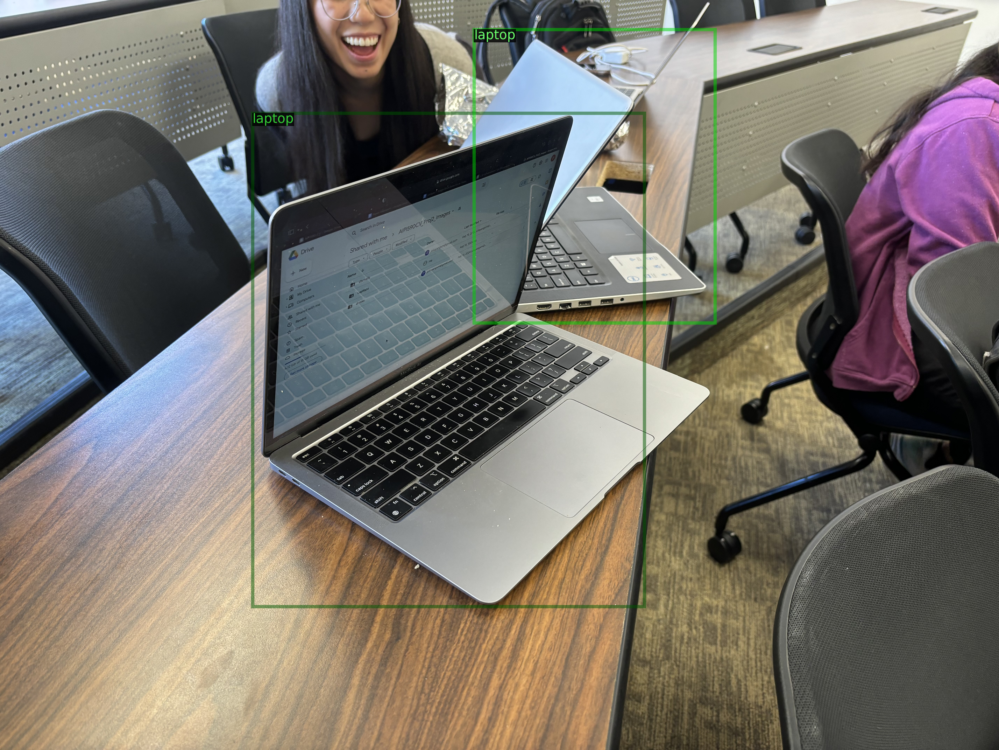

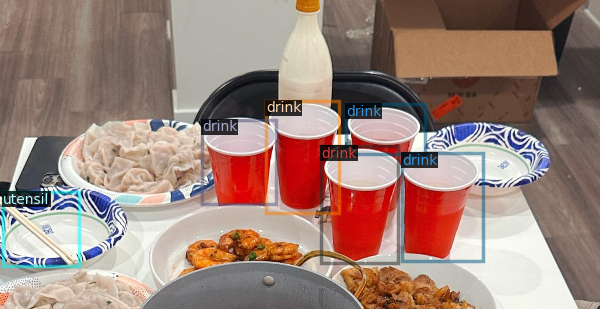

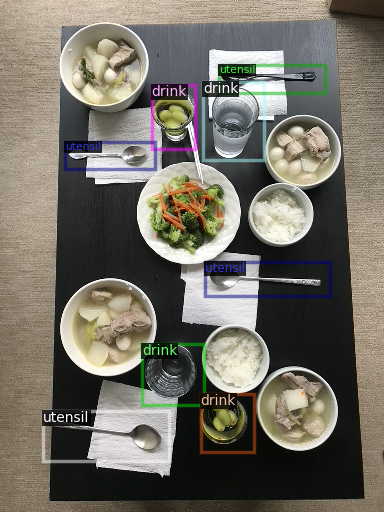

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.01 #from 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 3000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (200, 500, 1500,2000)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3

cfg.TEST.EVAL_PERIOD = 500

In [ ]:
from detectron2.data import detection_utils as utils
import detectron2.data.transforms as T
import copy

def custom_mapper(dataset_dict):
  image = utils.read_image(dataset_dict["file_name"], format="BGR")
  transform_list = [
      T.Resize((800,600)),
      T.RandomBrightness(0.8, 1.8),
      T.RandomContrast(0.6, 1.3),
      T.RandomSaturation(0.8, 1.4),
      T.RandomRotation(angle=[90, 90]),
      T.RandomLighting(0.7),
      T.RandomFlip(prob=0.4, horizontal=False, vertical=True),
  ]
  image, transforms = T.apply_transform_gens(transform_list, image)
  dataset_dict["image"] = torch.as_tensor(image.transpose(2, 0, 1).astype("float32"))

  annos = [
      utils.transform_instance_annotations(obj, transforms, image.shape[:2])
      for obj in dataset_dict.pop("annotations")
      if obj.get("iscrowd", 0) == 0
  ]
  instances = utils.annotations_to_instances(annos, image.shape[:2])
  dataset_dict["instances"] = utils.filter_empty_instances(instances)
  return dataset_dict

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.data import build_detection_train_loader

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

  @classmethod
  def build_train_loader(cls, cfg):
        return build_detection_train_loader(cfg, mapper=custom_mapper)


In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume = False)
trainer.train()

[03/07 02:04:15 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[03/07 02:04:16 d2.engine.train_loop]: Starting training from iteration 0
[03/07 02:05:01 d2.utils.events]:  eta: 1:19:38  iter: 19  total_loss: 2.194  loss_cls: 1.26  loss_box_reg: 0.8751  loss_rpn_cls: 0.0398  loss_rpn_loc: 0.01597    time: 1.8595  last_time: 1.5552  data_time: 1.2976  last_data_time: 0.6242   lr: 1.0285e-05  max_mem: 6652M
[03/07 02:05:40 d2.utils.events]:  eta: 1:26:58  iter: 39  total_loss: 2.028  loss_cls: 1.166  loss_box_reg: 0.8184  loss_rpn_cls: 0.02632  loss_rpn_loc: 0.01234    time: 1.9128  last_time: 2.2659  data_time: 0.9932  last_data_time: 1.3833   lr: 1.0585e-05  max_mem: 6652M
[03/07 02:06:20 d2.utils.events]:  eta: 1:18:33  iter: 59  total_loss: 2.052  loss_cls: 1.076  loss_box_reg: 0.9271  loss_rpn_cls: 0.04516  loss_rpn_loc: 0.01105    time: 1.9478  last_time: 2.2796  data_time: 1.0606  last_data_time: 1.2710   lr: 1.0885e-05  max_mem: 6652M
[03/07 02:06:56 d2.utils.events]:  eta: 1:22:18  iter: 79  total_loss: 1.966  loss_cls: 0.9809  loss_box_reg:

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/07 02:19:55 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.1459 s/iter. Inference: 0.1300 s/iter. Eval: 0.0008 s/iter. Total: 0.2768 s/iter. ETA=0:00:06
[03/07 02:20:01 d2.evaluation.evaluator]: Inference done 25/33. Dataloading: 0.2250 s/iter. Inference: 0.1475 s/iter. Eval: 0.0006 s/iter. Total: 0.3740 s/iter. ETA=0:00:02
[03/07 02:20:02 d2.evaluation.evaluator]: Total inference time: 0:00:08.813989 (0.314785 s / iter per device, on 1 devices)
[03/07 02:20:02 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:03 (0.134746 s / iter per device, on 1 devices)
[03/07 02:20:02 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/07 02:20:02 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/07 02:20:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/07 02:20:03 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/07 02:35:25 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.1494 s/iter. Inference: 0.1295 s/iter. Eval: 0.0005 s/iter. Total: 0.2794 s/iter. ETA=0:00:06
[03/07 02:35:31 d2.evaluation.evaluator]: Inference done 25/33. Dataloading: 0.2311 s/iter. Inference: 0.1573 s/iter. Eval: 0.0011 s/iter. Total: 0.3901 s/iter. ETA=0:00:03
[03/07 02:35:32 d2.evaluation.evaluator]: Total inference time: 0:00:09.097661 (0.324916 s / iter per device, on 1 devices)
[03/07 02:35:32 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:03 (0.141243 s / iter per device, on 1 devices)
[03/07 02:35:32 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/07 02:35:32 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/07 02:35:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/07 02:35:32 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/07 02:51:11 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.3910 s/iter. Inference: 0.2501 s/iter. Eval: 0.0004 s/iter. Total: 0.6415 s/iter. ETA=0:00:14
[03/07 02:51:17 d2.evaluation.evaluator]: Inference done 21/33. Dataloading: 0.3462 s/iter. Inference: 0.2367 s/iter. Eval: 0.0005 s/iter. Total: 0.5848 s/iter. ETA=0:00:07
[03/07 02:51:20 d2.evaluation.evaluator]: Total inference time: 0:00:12.540102 (0.447861 s / iter per device, on 1 devices)
[03/07 02:51:20 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:05 (0.186883 s / iter per device, on 1 devices)
[03/07 02:51:20 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/07 02:51:20 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/07 02:51:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/07 02:51:20 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/07 03:06:46 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.1660 s/iter. Inference: 0.1592 s/iter. Eval: 0.0004 s/iter. Total: 0.3256 s/iter. ETA=0:00:07
[03/07 03:06:52 d2.evaluation.evaluator]: Inference done 21/33. Dataloading: 0.2894 s/iter. Inference: 0.2040 s/iter. Eval: 0.0012 s/iter. Total: 0.4952 s/iter. ETA=0:00:05
[03/07 03:06:56 d2.evaluation.evaluator]: Total inference time: 0:00:11.501199 (0.410757 s / iter per device, on 1 devices)
[03/07 03:06:56 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:04 (0.173858 s / iter per device, on 1 devices)
[03/07 03:06:56 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/07 03:06:56 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/07 03:06:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/07 03:06:56 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/07 03:22:20 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.1294 s/iter. Inference: 0.1354 s/iter. Eval: 0.0004 s/iter. Total: 0.2652 s/iter. ETA=0:00:05
[03/07 03:22:26 d2.evaluation.evaluator]: Inference done 25/33. Dataloading: 0.2418 s/iter. Inference: 0.1518 s/iter. Eval: 0.0017 s/iter. Total: 0.3958 s/iter. ETA=0:00:03
[03/07 03:22:29 d2.evaluation.evaluator]: Total inference time: 0:00:09.999386 (0.357121 s / iter per device, on 1 devices)
[03/07 03:22:29 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:04 (0.148422 s / iter per device, on 1 devices)
[03/07 03:22:29 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/07 03:22:29 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/07 03:22:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/07 03:22:29 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/07 03:38:03 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.1297 s/iter. Inference: 0.1228 s/iter. Eval: 0.0019 s/iter. Total: 0.2544 s/iter. ETA=0:00:05
[03/07 03:38:09 d2.evaluation.evaluator]: Inference done 21/33. Dataloading: 0.3024 s/iter. Inference: 0.1867 s/iter. Eval: 0.0039 s/iter. Total: 0.4937 s/iter. ETA=0:00:05
[03/07 03:38:12 d2.evaluation.evaluator]: Total inference time: 0:00:11.104645 (0.396594 s / iter per device, on 1 devices)
[03/07 03:38:12 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:04 (0.155943 s / iter per device, on 1 devices)
[03/07 03:38:12 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/07 03:38:12 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/07 03:38:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/07 03:38:12 d2.evaluation.

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
results = inference_on_dataset(trainer.model, val_loader, evaluator)

[03/07 03:38:22 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [03/07 03:38:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/07 03:38:23 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/CV_individualproject/test_coco_annotations.json
[03/07 03:38:23 d2.data.build]: Distribution of instances among all 3 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|   drink    | 28           |   laptop   | 13           |  utensil   | 26           |
|            |              |            |              |            |              |
|   total    | 67           |            |              |            |              |
[03/07 03:38:23 d2.data.dataset_mapper]: [DatasetMa

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/07 03:38:28 d2.evaluation.evaluator]: Inference done 11/31. Dataloading: 0.1919 s/iter. Inference: 0.1158 s/iter. Eval: 0.0006 s/iter. Total: 0.3083 s/iter. ETA=0:00:06
[03/07 03:38:36 d2.evaluation.evaluator]: Inference done 21/31. Dataloading: 0.4361 s/iter. Inference: 0.1276 s/iter. Eval: 0.0005 s/iter. Total: 0.5644 s/iter. ETA=0:00:05
[03/07 03:38:40 d2.evaluation.evaluator]: Total inference time: 0:00:13.179012 (0.506885 s / iter per device, on 1 devices)
[03/07 03:38:40 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:03 (0.132044 s / iter per device, on 1 devices)
[03/07 03:38:40 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/07 03:38:40 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[03/07 03:38:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/07 03:38:40 d2.evaluation.f

In [ ]:
!pip install tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
%reload_ext tensorboard

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


{'instances': Instances(num_instances=2, image_height=1024, image_width=768, fields=[pred_boxes: Boxes(tensor([[388.4630, 550.3901, 766.1542, 938.7684],
        [ 80.8314,   0.0000, 287.9142, 252.3362]], device='cuda:0')), scores: tensor([0.9635, 0.7077], device='cuda:0'), pred_classes: tensor([2, 0], device='cuda:0')])}


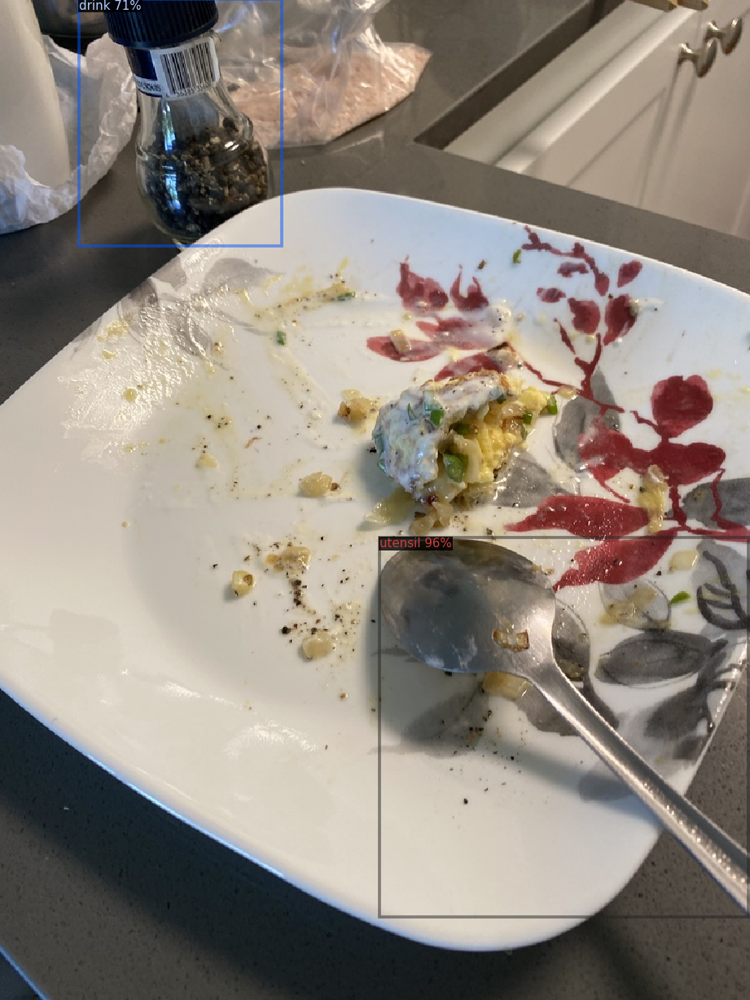

{'instances': Instances(num_instances=1, image_height=3024, image_width=3024, fields=[pred_boxes: Boxes(tensor([[1403.3826,    0.0000, 2060.0750,  660.6667]], device='cuda:0')), scores: tensor([0.9664], device='cuda:0'), pred_classes: tensor([2], device='cuda:0')])}


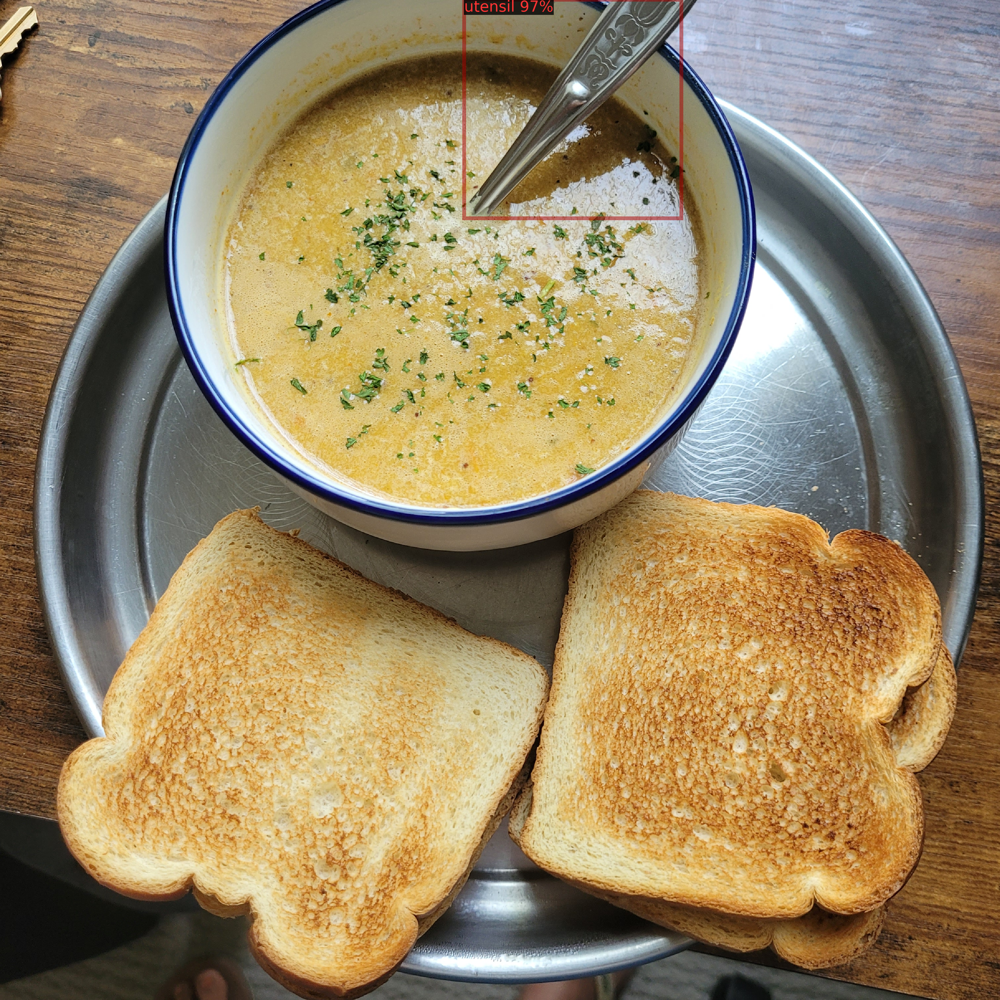

In [ ]:
from detectron2.utils.visualizer import Visualizer

# Visualize predictions for a few images
for i, input_data in enumerate(val_loader):
  image = cv2.imread(input_data[0]["file_name"])
  outputs = predictor(image)

  v = Visualizer(image[:, :, ::-1], metadata=MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=0.5)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

  cv2_imshow(out.get_image()[:, :, ::-1])
  cv2.waitKey(0)
  cv2.destroyAllWindows()

